In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.cuda
import torchvision.transforms.functional as TF
import torchvision.transforms as transforms
import os
import random
from PIL import Image
from tqdm.notebook import tqdm
from torch.nn.functional import relu
from torch.utils.data import DataLoader, Dataset
from sklearn.manifold import TSNE
from SHG import SHG
from utils import *
from skimage.transform import resize
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from sklearn.decomposition import PCA

torch.backends.cudnn.deterministic = True
random.seed(1)
torch.manual_seed(1)
torch.cuda.manual_seed(1)
np.random.seed(1)

In [2]:
# Input images
TRAIN_IMGS_PATH = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/train/image/"
VAL_IMGS_PATH = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/validation/image/"

# Ground truth heatmaps
TRAIN_HEATMAPS_PATH = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/train/heatmaps/"
VAL_HEATMAPS_PATH = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/validation/heatmaps/"

MODEL_DIR = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/models/Mon_Apr_12_18-11-59_2021/epoch_46.pth"

average_rgb = np.loadtxt("./average_rgb.npy")

In [3]:
class dataset(Dataset):
    def __init__(self, X_path, y_path, average_rgb):
        self.X_path = X_path
        self.y_path = y_path
        self.X_data = os.listdir(self.X_path)
        self.average_rgb = average_rgb
        self.norm = transforms.Normalize(mean = self.average_rgb, std = [1, 1, 1])
        self.order = ['0.npy', '1.npy', '10.npy', '11.npy', '12.npy', '13.npy', '14.npy', '15.npy', '16.npy', '2.npy', '3.npy', '4.npy', '5.npy', '6.npy', '7.npy', '8.npy', '9.npy']

    def __len__(self):
        return len(self.X_data)

    def __getitem__(self, i):
        ID = self.X_data[i]
        x = Image.open(self.X_path + ID)

        y = []

        for i in range(17):
            y.append(torch.from_numpy(np.load(self.y_path + ID[:-4] + "/" + str(i) + ".npy")))

        x = TF.to_tensor(x)

        if (x.shape[0] == 1): # If the image is gray-scale, cast it to rgb
            x = torch.stack((x[0],) * 3)

        x = self.norm(x) # Subtracts mean rgb

        y = torch.stack(y)
        return x, y

train_data = dataset(TRAIN_IMGS_PATH, TRAIN_HEATMAPS_PATH, average_rgb)
val_data = dataset(VAL_IMGS_PATH, VAL_HEATMAPS_PATH, average_rgb)

train_dataloader = DataLoader(train_data, batch_size = 1, shuffle = True)
val_dataloader = DataLoader(val_data, batch_size = 1)

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = SHG(num_hourglasses=1).to(device)
model.load_state_dict(torch.load(MODEL_DIR))
model.eval()
print("")

In [15]:
NUM_DATAPOINTS = 5000

bottleneck_1 = []
bottleneck_2 = []
bottleneck_3 = []
gt_heatmaps = []

with torch.no_grad():
    for x, y in tqdm(train_dataloader):
        print(len(bottleneck_1))
        skip = False
        x = x.to(device, dtype = torch.float)

        if (0 in turn_featuremaps_to_keypoints(y)):
            continue

        _, bottleneck = model(x)
        
        bottleneck_1.append(torch.flatten(bottleneck[0]).cpu().numpy())
        bottleneck_2.append(torch.flatten(bottleneck[1]).cpu().numpy())
        bottleneck_3.append(torch.flatten(bottleneck[2]).cpu().numpy())
        gt_heatmaps.append(turn_featuremaps_to_keypoints(y))

        if (len(bottleneck_1) == NUM_DATAPOINTS):
            break

bottleneck_1 = np.array(bottleneck_1).reshape((NUM_DATAPOINTS, -1))
bottleneck_2 = np.array(bottleneck_2).reshape((NUM_DATAPOINTS, -1))
bottleneck_3 = np.array(bottleneck_3).reshape((NUM_DATAPOINTS, -1))
gt_heatmaps = np.array(gt_heatmaps).reshape((NUM_DATAPOINTS, -1))

764
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4765
4766
4766
4766
4766
4766
4766
4766
4766
4766
4767
4767
4768
4768
4768
4768
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4769
4770
4770
4770
4770
4770
4770
4770
4771
4771
4771
4771
4771
4772
4772
4772
4772
4772
4772
4772
4772
4772
4772
4772
4772
4772
4772
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4773
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4774
4775
4775
4776
4777
4777
4777
4777
4777
4777
4777
4777
4777
4777
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4778
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4779
4

In [16]:
# Learning rate har ikke den store effekt
bottleneck_1_embedded = TSNE(n_components=2, learning_rate=500, random_state=0, perplexity = 20).fit_transform(bottleneck_1)
print("TSNE 1 DONE!")
bottleneck_2_embedded = TSNE(n_components=2, learning_rate=500, random_state=0, perplexity = 20).fit_transform(bottleneck_2)
print("TSNE 2 DONE!")
bottleneck_3_embedded = TSNE(n_components=2, learning_rate=500, random_state=0, perplexity = 20).fit_transform(bottleneck_3)
print("TSNE 3 DONE!")

TSNE 1 DONE!
TSNE 2 DONE!
TSNE 3 DONE!


In [17]:
# 2 components
pca_1 = PCA(n_components=2, random_state=0).fit(bottleneck_1)
bottleneck_1_embedded_pca = pca_1.transform(bottleneck_1)
print("PCA 1 DONE!. Explained variance", sum(pca_1.explained_variance_ratio_))

pca_2 = PCA(n_components=2, random_state=0).fit(bottleneck_2)
bottleneck_2_embedded_pca = pca_2.transform(bottleneck_2)
print("PCA 2 DONE!. Explained variance", sum(pca_2.explained_variance_ratio_))

pca_3 = PCA(n_components=2, random_state=0).fit(bottleneck_3)
bottleneck_3_embedded_pca = pca_3.transform(bottleneck_3)
print("PCA 3 DONE!. Explained variance", sum(pca_3.explained_variance_ratio_))

PCA 1 DONE!. Explained variance 0.1132544782012701
PCA 2 DONE!. Explained variance 0.1649017259478569
PCA 3 DONE!. Explained variance 0.5632806289941072


In [18]:
zoom = 0.5
fig_size = (20, 15)

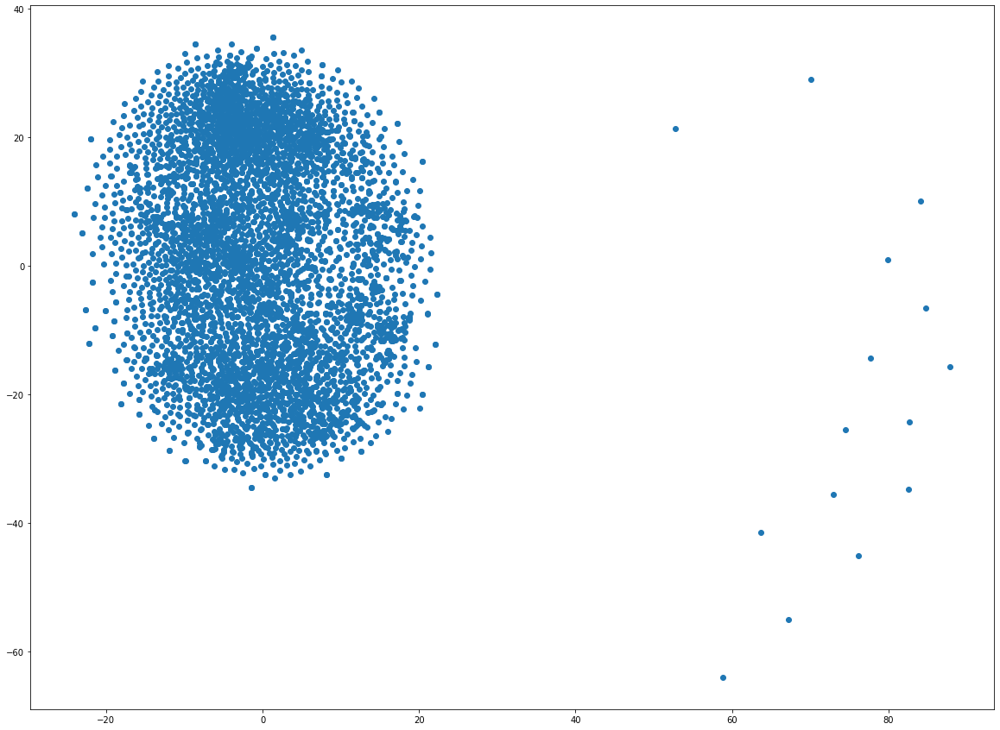

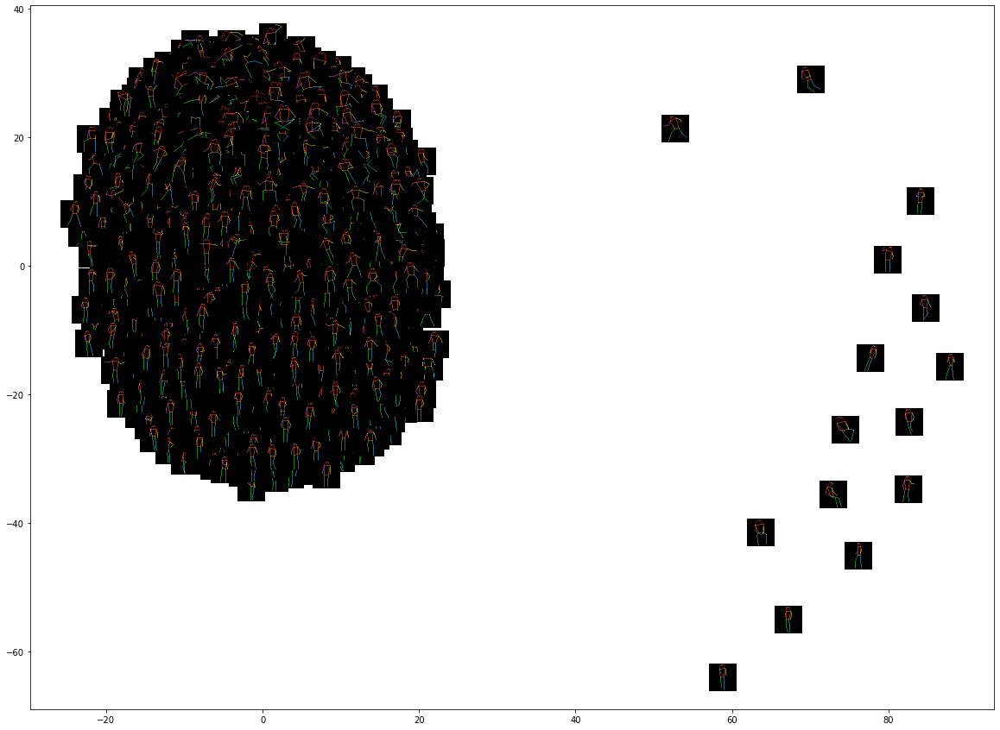

In [19]:
plt.figure(figsize=fig_size)
plt.scatter(bottleneck_1_embedded[:, 0], bottleneck_1_embedded[:, 1])
#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_1_tsne_scatter.png".format(NUM_DATAPOINTS))
plt.show()

fig, ax = plt.subplots(figsize = fig_size)
for tsne, img in zip(bottleneck_1_embedded, gt_heatmaps):
    image = draw_skeleton(np.round(img))
    im = OffsetImage(image, zoom = zoom)
    ab = AnnotationBbox(im, (tsne[0], tsne[1]), xycoords = "data", frameon = False)
    ax.add_artist(ab)
    ax.update_datalim([(tsne[0], tsne[1])])
    ax.autoscale()

#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_1_tsne_imgs.png".format(NUM_DATAPOINTS))
plt.show()

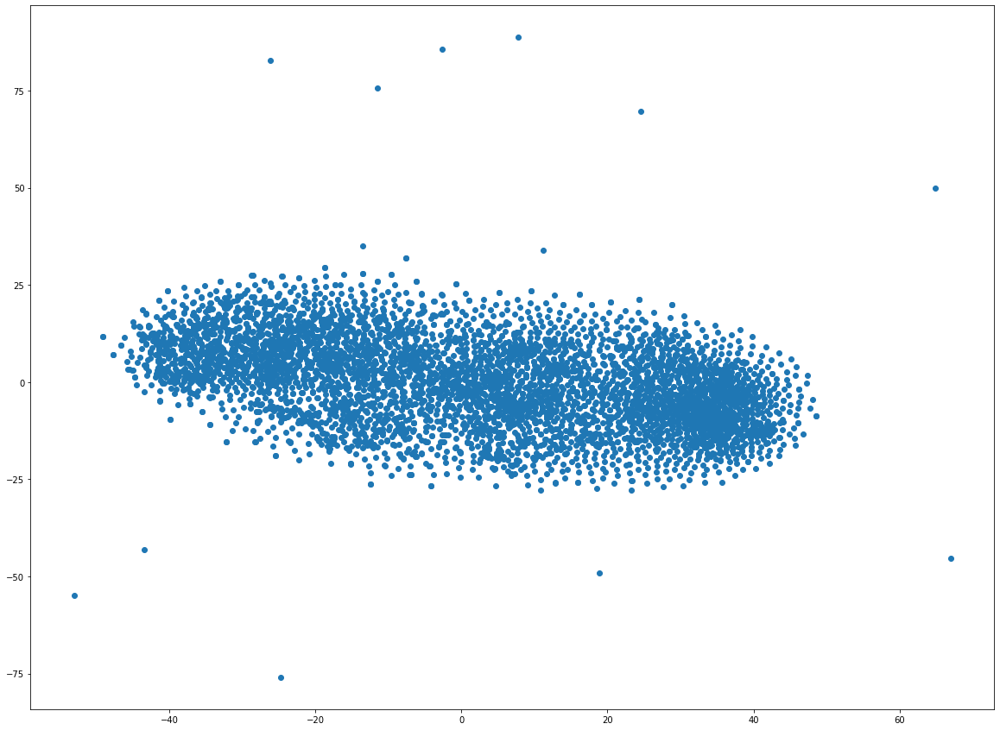

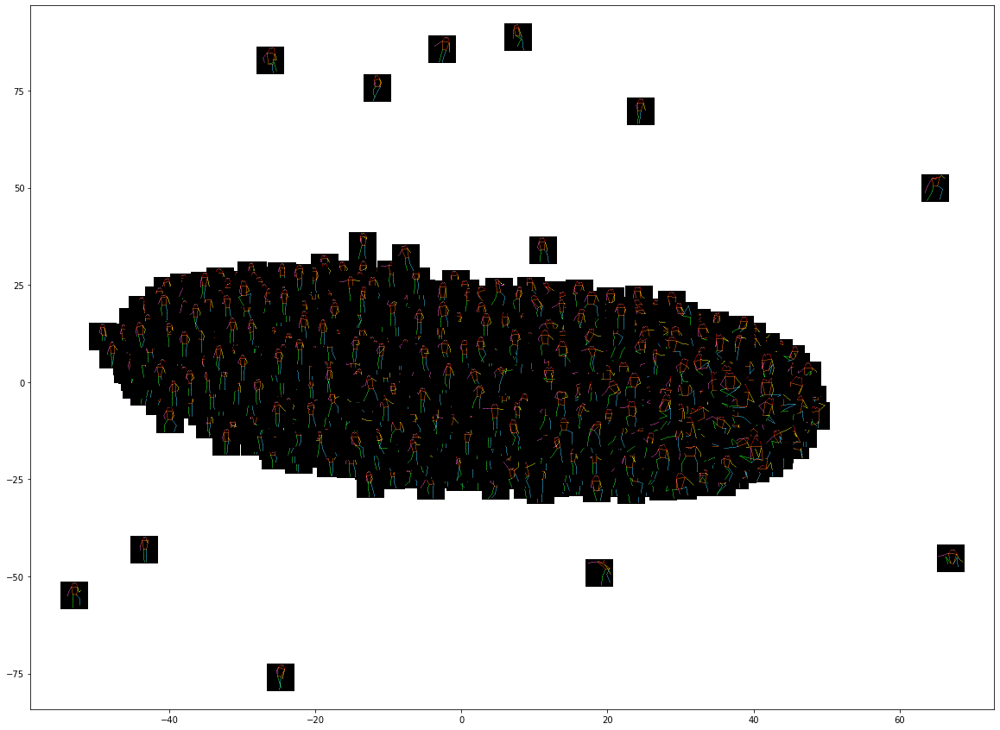

In [20]:
plt.figure(figsize=fig_size)
plt.scatter(bottleneck_2_embedded[:, 0], bottleneck_2_embedded[:, 1])
#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_2_tsne_scatter.png".format(NUM_DATAPOINTS))
plt.show()

fig, ax = plt.subplots(figsize = fig_size)
for tsne, img in zip(bottleneck_2_embedded, gt_heatmaps):
    image = draw_skeleton(np.round(img))
    im = OffsetImage(image, zoom = zoom)
    ab = AnnotationBbox(im, (tsne[0], tsne[1]), xycoords = "data", frameon = False)
    ax.add_artist(ab)
    ax.update_datalim([(tsne[0], tsne[1])])
    ax.autoscale()

#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_2_tsne_imgs.png".format(NUM_DATAPOINTS))
plt.show()

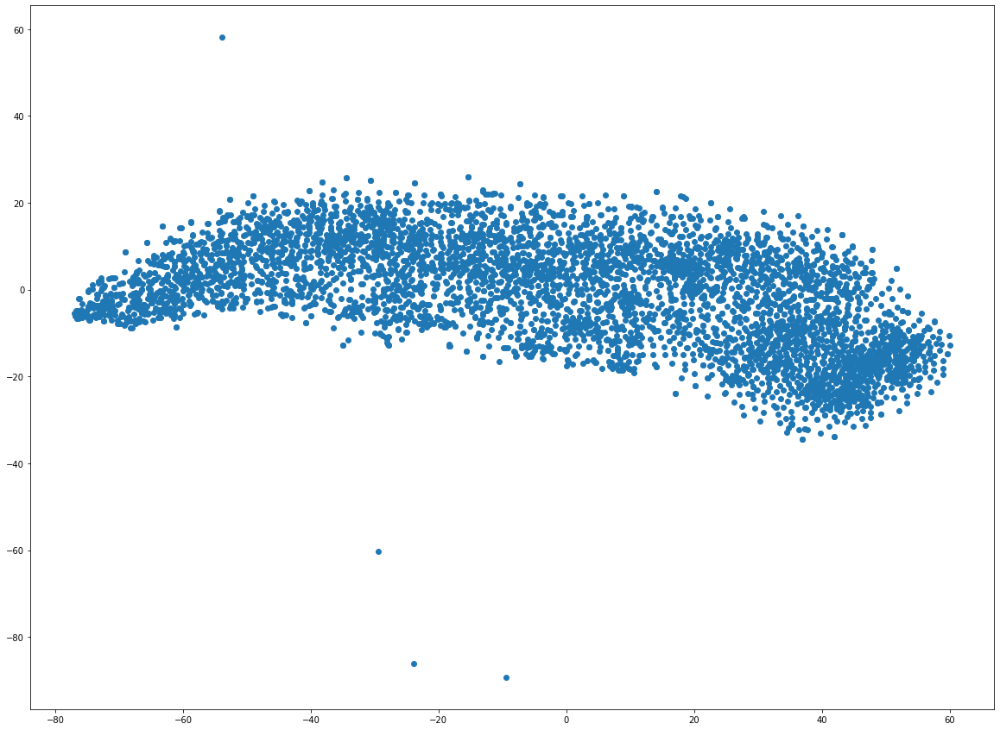

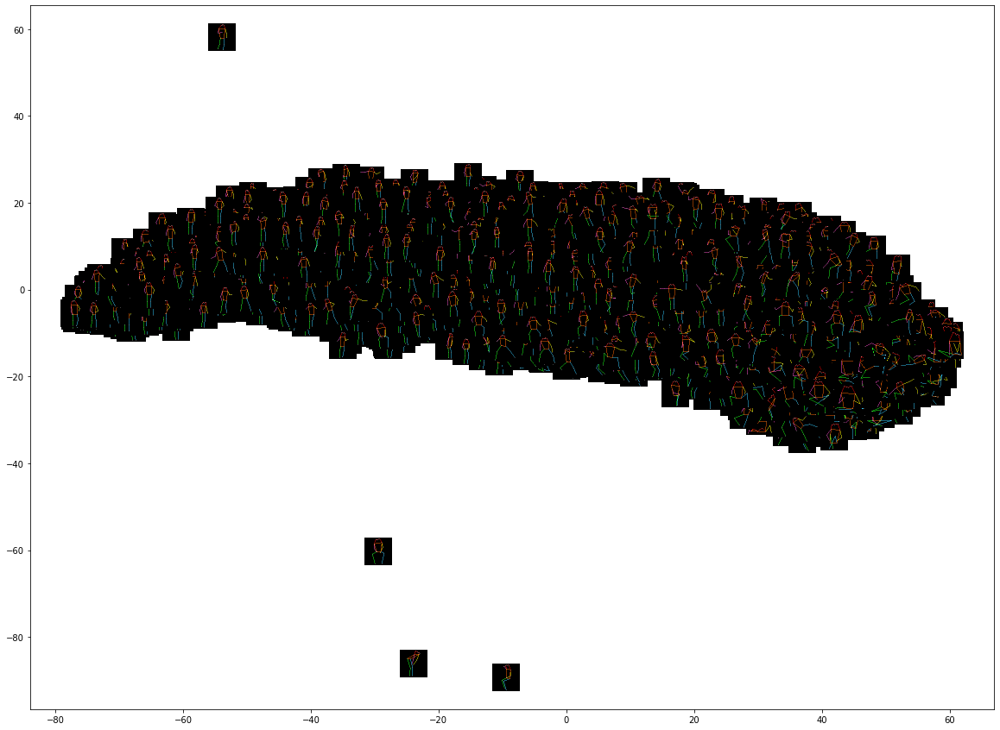

In [21]:
plt.figure(figsize = fig_size)
plt.scatter(bottleneck_3_embedded[:, 0], bottleneck_3_embedded[:, 1])
#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_3_tsne_scatter.png".format(NUM_DATAPOINTS))
plt.show()

fig, ax = plt.subplots(figsize = fig_size)
for tsne, img in zip(bottleneck_3_embedded, gt_heatmaps):
    image = draw_skeleton(np.round(img))
    im = OffsetImage(image, zoom = zoom)
    ab = AnnotationBbox(im, (tsne[0], tsne[1]), xycoords = "data", frameon = False)
    ax.add_artist(ab)
    ax.update_datalim([(tsne[0], tsne[1])])
    ax.autoscale()

#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_3_tsne_imgs.png".format(NUM_DATAPOINTS))
plt.show()

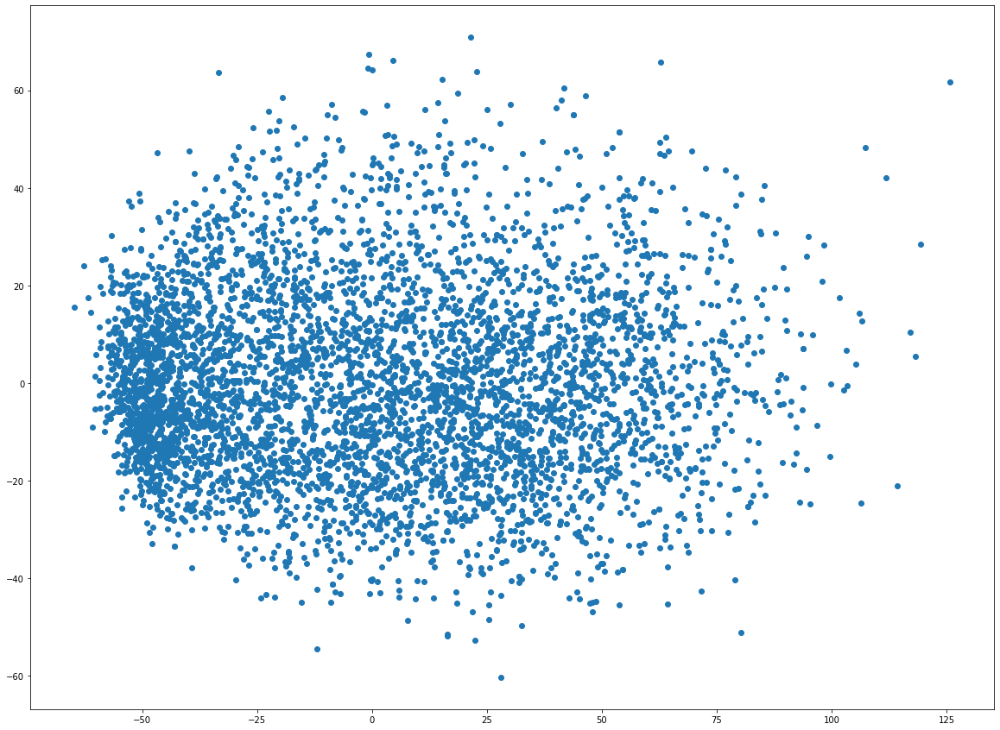

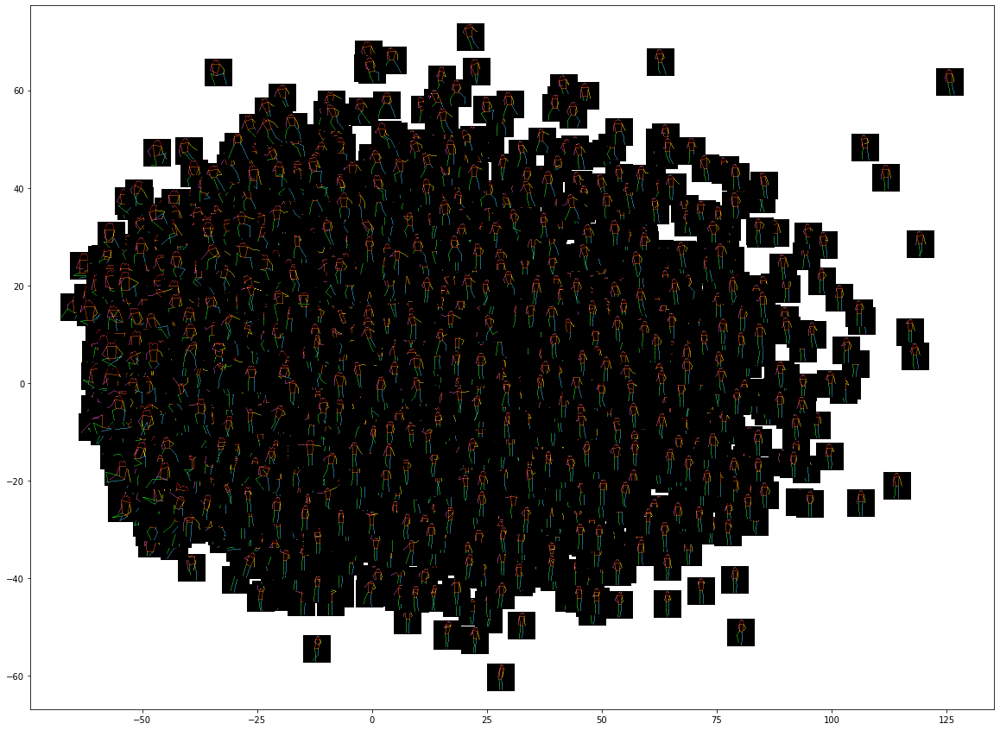

In [22]:
plt.figure(figsize = fig_size)
plt.scatter(bottleneck_1_embedded_pca[:, 0], bottleneck_1_embedded_pca[:, 1])
#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_1_pca_scatter.png".format(NUM_DATAPOINTS))
plt.show()

fig, ax = plt.subplots(figsize = fig_size)
for pca, img in zip(bottleneck_1_embedded_pca, gt_heatmaps):
    image = draw_skeleton(np.round(img))
    im = OffsetImage(image, zoom = zoom)
    ab = AnnotationBbox(im, (pca[0], pca[1]), xycoords = "data", frameon = False)
    ax.add_artist(ab)
    ax.update_datalim([(pca[0], pca[1])])
    ax.autoscale()

#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_1_pca_imgs.png".format(NUM_DATAPOINTS))
plt.show()

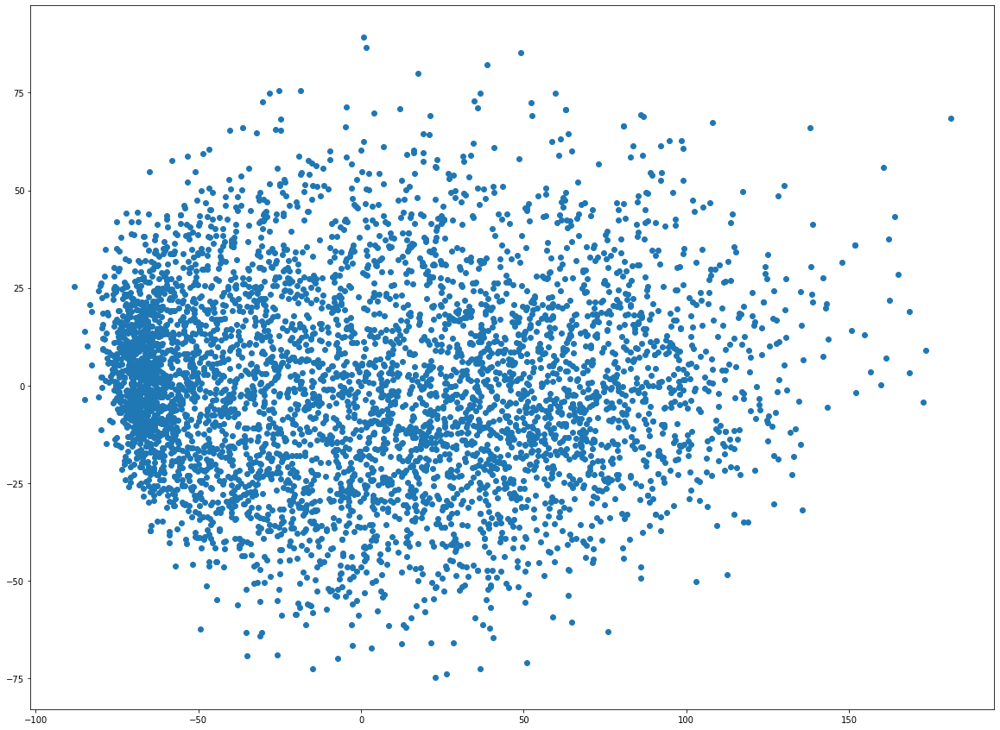

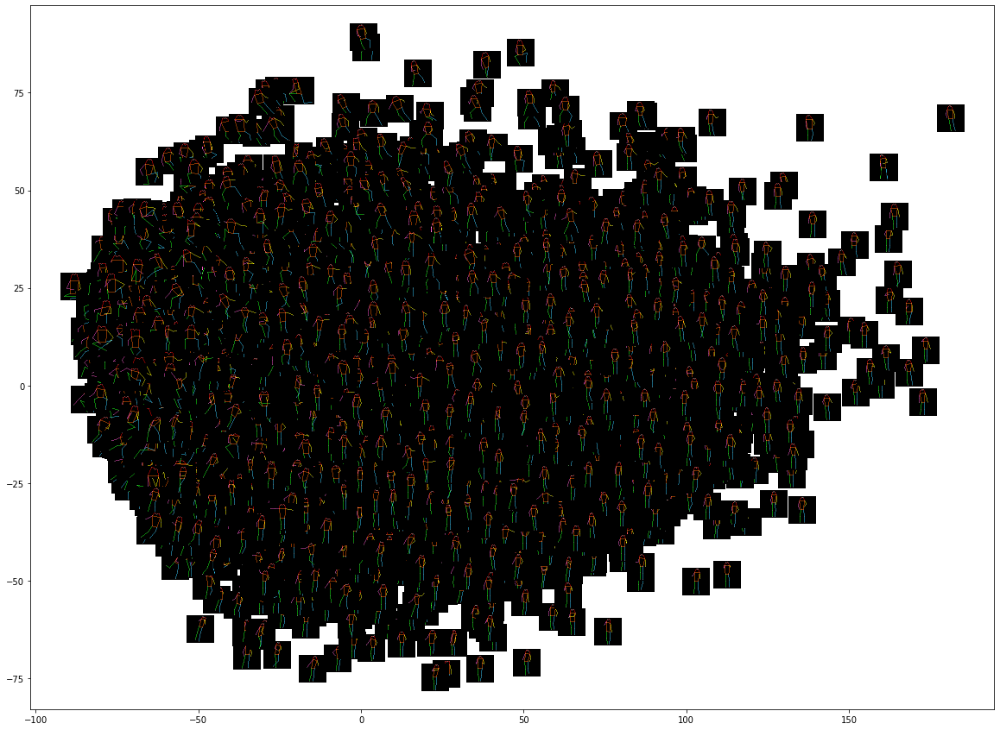

In [23]:
plt.figure(figsize = fig_size)
plt.scatter(bottleneck_2_embedded_pca[:, 0], bottleneck_2_embedded_pca[:, 1])
#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_2_pca_scatter.png".format(NUM_DATAPOINTS))
plt.show()

fig, ax = plt.subplots(figsize = fig_size)
for pca, img in zip(bottleneck_2_embedded_pca, gt_heatmaps):
    image = draw_skeleton(np.round(img))
    im = OffsetImage(image, zoom = zoom)
    ab = AnnotationBbox(im, (pca[0], pca[1]), xycoords = "data", frameon = False)
    ax.add_artist(ab)
    ax.update_datalim([(pca[0], pca[1])])
    ax.autoscale()

#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_2_pca_imgs.png".format(NUM_DATAPOINTS))
plt.show()

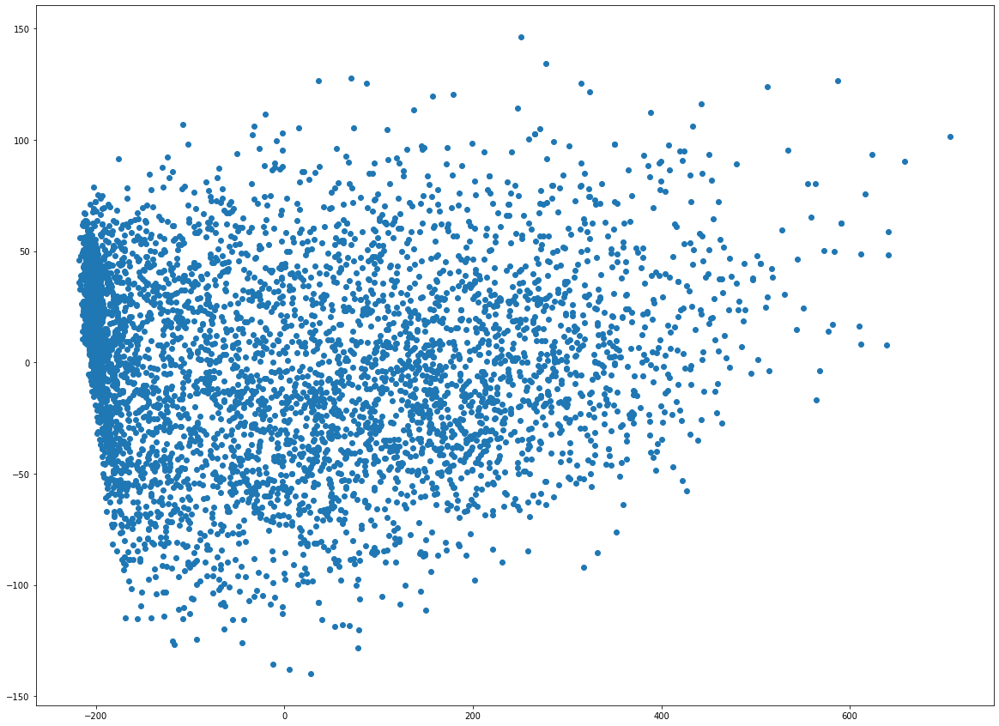

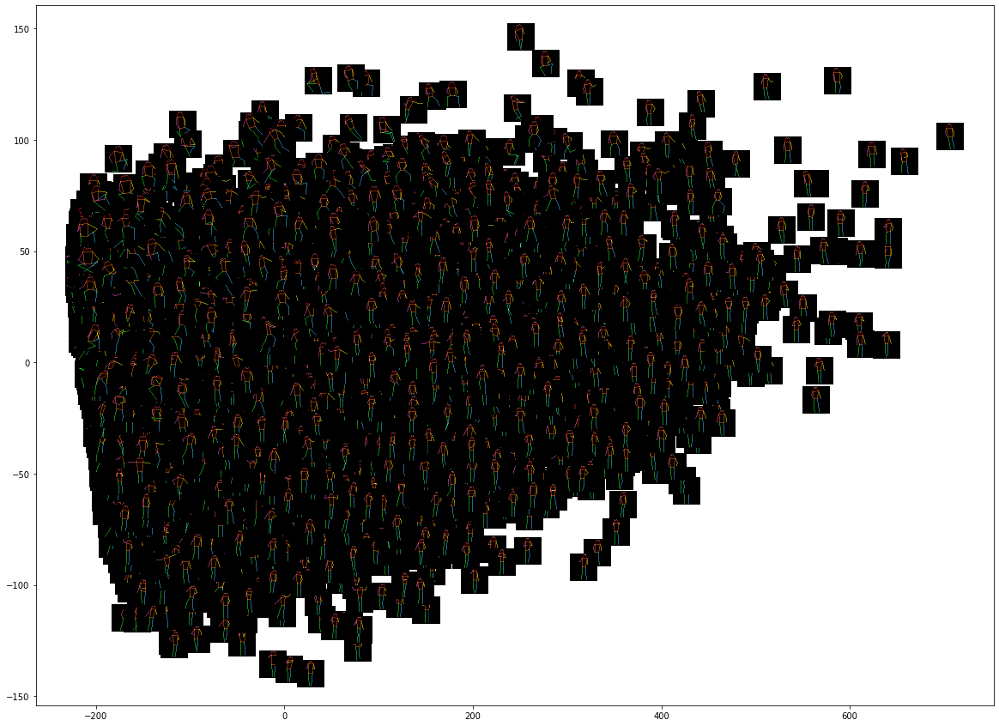

In [24]:
plt.figure(figsize = fig_size)
plt.scatter(bottleneck_3_embedded_pca[:, 0], bottleneck_3_embedded_pca[:, 1])
#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_3_pca_scatter.png".format(NUM_DATAPOINTS))
plt.show()

fig, ax = plt.subplots(figsize = fig_size)
for pca, img in zip(bottleneck_3_embedded_pca, gt_heatmaps):
    image = draw_skeleton(np.round(img))
    im = OffsetImage(image, zoom = zoom)
    ab = AnnotationBbox(im, (pca[0], pca[1]), xycoords = "data", frameon = False)
    ax.add_artist(ab)
    ax.update_datalim([(pca[0], pca[1])])
    ax.autoscale()

#plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/visualization/{}/train/bottleneck_3_pca_imgs.png".format(NUM_DATAPOINTS))
plt.show()